In [6]:
import tomopy
import dxchange
import matplotlib.pyplot as plt
import datetime
import time
#import logging
#logging.basicConfig(level=logging.INFO)
from imagestacks import create_animation # permet de mettre une image en donnée dans un tableau
from IPython.core.display import HTML


In [7]:
fname='/Users/leapommier/Desktop/projet multi/tilt_0_180/carteSD120321_0000.tif'
ind = [i for i in range(180)] 
print(ind)
print(fname)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179]
/Users/leapommier/Desktop/projet multi/tilt_0_180/carteSD120321_0000.tif


In [8]:
start = datetime.datetime.now()
proj = dxchange.reader.read_tiff_stack(fname,ind) 
end = datetime.datetime.now()
duree = end - start
duree
print(duree)

0:00:10.420131


In [9]:
#diminuer la taille des images
print('avant',proj.shape)
down = tomopy.misc.morph.downsample(proj, level=1, axis=1) #axe 1= ligne 
down = tomopy.misc.morph.downsample(down, level=1, axis=2) # axe 2= colonne 0= moyenne image attention 
print('apres',down.shape)

avant (180, 1388, 1038)
apres (180, 694, 519)


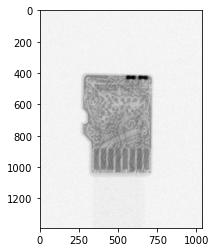

In [10]:
#afficher la  1ere image avant downsampling
image0 = proj[0,:,:] # attention que pour affichage 
plt.imshow(image0, cmap='Greys_r')
plt.show()

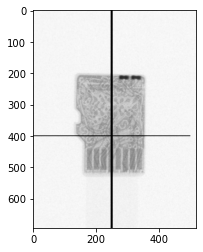

In [11]:
#afficher la  1ere image apres downsampling
image0 = down[0, :, :]

import cv2

for k in range(180):
    
    down[k, :, :]= cv2.line(down[k, :, :], (250,0),(250,700), (255,255,255),6) #tracé de la ligne pour verifier le centre de rotation
    down[k, :, :]= cv2.line(down[k, :, :], (0,400),(500,400), (255,255,255),2) #verif perpendicularité axe rot
plt.imshow(image0, cmap='Greys_r') 
plt.show()

In [12]:
anim2 = create_animation(down,size=4)
display(HTML(anim2.to_jshtml()))

In [13]:
#normaliser ave loi log pour loi de beer lambert
norm = tomopy.prep.normalize.minus_log(down, ncore=None, out=None)

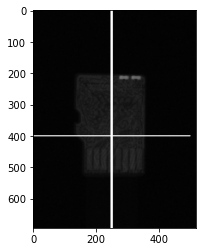

In [14]:
#afficher la  1ere image normalisee
image0 = norm[0, :, :]
plt.imshow(image0, cmap='Greys_r')
plt.show()

In [15]:
ang = tomopy.angles(180) # Generate uniformly spaced tilt angles.

In [16]:
anim2 = create_animation(norm, size=4)
display(HTML(anim2.to_jshtml()))

In [ ]:
import tomopy
import dxchange
import matplotlib.pyplot as plt
import datetime
import time

norm = tomopy.prep.normalize.minus_log(down, ncore=None, out=None)
ang = tomopy.angles(180)

rot_center = tomopy.find_center(norm, ang, init=None, ind=0, tol=0.5)
rec = tomopy.recon(norm, ang, center=rot_center, algorithm='gridrec')
print(rec)

In [ ]:
import cv2

for k in range(180):
    
    down[k, :, :]= cv2.line(down[k, :, :], (250,0),(250,700), (255,255,255),6) #tracé de la ligne pour verifier le centre de rotation
    down[k, :, :]= cv2.line(down[k, :, :], (0,400),(500,400), (255,255,255),2) #verif perpendicularité axe rot

In [ ]:
print('debut')
start = datetime.datetime.now()
rec = tomopy.recon(norm, ang,250,algorithm='fbp') # Reconstruct object.
end = datetime.datetime.now()
duree = end - start
duree
print('fin')
print(duree)

In [ ]:
plt.imshow(rec[290,100:350,100:350],cmap='gray')
plt.show()
l=len(rec)
print(l)


In [ ]:
anim2 = create_animation(rec[:,100:350,100:350], size=4)
display(HTML(anim2.to_jshtml()))

In [ ]:
#afficher les images où la reconstruction est visible : moyenne d'intensité d'image 
# tracer un rectangle a l'interieur du disque avant l'affichage fonction existe deja okkk
# essayer la fbp à la place de gridrec 
# pb d'affichage, contraste par rapport au bruit 
# tester nouveau algo 
# open cv ou pil pour save okkkkk


In [ ]:
import cv2
for i in range(0,694):
    recon=rec[i,100:350,100:350]
    cv2.imwrite("/Users/leapommier/Desktop/esssai sauvegarde/sauv%i.tif"%i,recon)
    

In [ ]:
import matplotlib.image as mpim
IMAGE="imagerecdeuxiemeversion%d.png"
for i in range (0,694):
    fichier=IMAGE %i
    mpim.imsave(fichier,rec[i,100:350,100:350])
    i=i+1